In [1]:
#
# For licensing see accompanying LICENSE file.
# Copyright (C) 2024 Apple Inc. All Rights Reserved.
#

In [2]:
import os
from tqdm.auto import tqdm
from PIL import Image
import torch as T
import transformers, diffusers
from llava.conversation import conv_templates
from llava.model import *

def crop_resize(f, sz=512):
    w, h = f.size
    if w>h:
        p = (w-h)//2
        f = f.crop([p, 0, p+h, h])
    elif h>w:
        p = (h-w)//2
        f = f.crop([0, p, w, p+w])
    f = f.resize([sz, sz])
    return f
def remove_alter(s):  # hack expressive instruction
    if 'ASSISTANT:' in s: s = s[s.index('ASSISTANT:')+10:].strip()
    if '</s>' in s: s = s[:s.index('</s>')].strip()
    if 'alternative' in s.lower(): s = s[:s.lower().index('alternative')]
    if '[IMG0]' in s: s = s[:s.index('[IMG0]')]
    s = '.'.join([s.strip() for s in s.split('.')[:2]])
    if s[-1]!='.': s += '.'
    return s.strip()

In [3]:
DEFAULT_IMAGE_TOKEN = '<image>'
DEFAULT_IMAGE_PATCH_TOKEN = '<im_patch>'
DEFAULT_IM_START_TOKEN = '<im_start>'
DEFAULT_IM_END_TOKEN = '<im_end>'
PATH_LLAVA = '../autodl-tmp/LLaVA-7B-v1'

tokenizer = transformers.AutoTokenizer.from_pretrained(PATH_LLAVA)
model = LlavaLlamaForCausalLM.from_pretrained(PATH_LLAVA, low_cpu_mem_usage=True, torch_dtype=T.float16, use_cache=True).cuda()
image_processor = transformers.CLIPImageProcessor.from_pretrained(model.config.mm_vision_tower, torch_dtype=T.float16)

tokenizer.padding_side = 'left'
tokenizer.add_tokens(['[IMG0]', '[IMG1]', '[IMG2]', '[IMG3]', '[IMG4]', '[IMG5]', '[IMG6]', '[IMG7]'], special_tokens=True)
model.resize_token_embeddings(len(tokenizer))
ckpt = T.load('./_ckpt/mgie_7b/mllm.pt', map_location='cpu')
model.load_state_dict(ckpt, strict=False)

mm_use_im_start_end = getattr(model.config, 'mm_use_im_start_end', False)
tokenizer.add_tokens([DEFAULT_IMAGE_PATCH_TOKEN], special_tokens=True)
if mm_use_im_start_end: tokenizer.add_tokens([DEFAULT_IM_START_TOKEN, DEFAULT_IM_END_TOKEN], special_tokens=True)

vision_tower = model.get_model().vision_tower[0]
vision_tower = transformers.CLIPVisionModel.from_pretrained(vision_tower.config._name_or_path, torch_dtype=T.float16, low_cpu_mem_usage=True).cuda()
model.get_model().vision_tower[0] = vision_tower
vision_config = vision_tower.config
vision_config.im_patch_token = tokenizer.convert_tokens_to_ids([DEFAULT_IMAGE_PATCH_TOKEN])[0]
vision_config.use_im_start_end = mm_use_im_start_end
if mm_use_im_start_end: vision_config.im_start_token, vision_config.im_end_token = tokenizer.convert_tokens_to_ids([DEFAULT_IM_START_TOKEN, DEFAULT_IM_END_TOKEN])
image_token_len = (vision_config.image_size//vision_config.patch_size)**2

_ = model.eval()
EMB = ckpt['emb'].cuda()
with T.inference_mode(): NULL = model.edit_head(T.zeros(1, 8, 4096).half().to('cuda'), EMB)
print('NULL:', NULL.shape)

Some weights of the model checkpoint at ../autodl-tmp/clip-vit-large-patch14 were not used when initializing CLIPVisionModel: ['text_model.embeddings.position_ids', 'text_model.encoder.layers.7.self_attn.out_proj.weight', 'text_model.encoder.layers.10.layer_norm1.bias', 'text_model.encoder.layers.5.self_attn.out_proj.weight', 'text_model.encoder.layers.4.layer_norm1.bias', 'text_model.encoder.layers.0.layer_norm1.weight', 'text_model.encoder.layers.8.self_attn.q_proj.weight', 'text_model.encoder.layers.2.layer_norm2.weight', 'text_model.encoder.layers.3.self_attn.out_proj.weight', 'text_model.encoder.layers.10.self_attn.k_proj.weight', 'text_model.encoder.layers.0.layer_norm2.bias', 'text_model.encoder.layers.3.mlp.fc2.bias', 'text_model.encoder.layers.1.self_attn.out_proj.bias', 'text_model.encoder.layers.8.self_attn.k_proj.weight', 'text_model.encoder.layers.4.self_attn.out_proj.weight', 'text_model.encoder.layers.10.self_attn.out_proj.bias', 'text_model.encoder.layers.5.mlp.fc1.weig

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Some weights of LlavaLlamaForCausalLM were not initialized from the model checkpoint at ../autodl-tmp/LLaVA-7B-v1 and are newly initialized: ['vae.decoder.up_blocks.0.resnets.0.norm2.bias', 'vae.decoder.up_blocks.3.resnets.1.norm2.weight', 'edit_head.mapper.encoder.layers.3.norm2.weight', 'unet.down_blocks.1.attentions.1.transformer_blocks.0.ff.net.2.bias', 'vae.decoder.mid_block.attentions.0.to_q.weight', 'unet.down_blocks.0.attentions.1.transformer_blocks.0.ff.net.0.proj.weight', 'unet.up_blocks.2.attentions.1.transformer_blocks.0.attn2.to_k.weight', 'unet.down_blocks.2.resnets.1.conv1.weight', 'edit_head.mapper.decoder.layers.1.norm3.weight', 'unet.up_blocks.2.resnets.1.norm1.weight', 'unet.up_blocks.0.resnets.2.conv1.bias', 'vae.encoder.down_blocks.3.resnets.0.conv2.bias', 'vae.decoder.up_blocks.3.resnets.2.norm2.weight', 'unet.down_blocks.1.attentions.1.transformer_blocks.0.norm1.bias', 'unet.mid_block.attentions.0.norm.bias', 'edit_head.mapper.encoder.layers.1.self_attn.out_proj.

NULL: torch.Size([1, 77, 768])


In [4]:
pipe = diffusers.StableDiffusionInstructPix2PixPipeline.from_pretrained('/root/autodl-tmp/ip2p', torch_dtype=T.float16, safety_checker=None).to('cuda')
pipe.set_progress_bar_config(disable=True)
pipe.unet.load_state_dict(T.load('./_ckpt/mgie_7b/unet.pt', map_location='cpu'))

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

<All keys matched successfully>

  0%|          | 0/20 [00:00<?, ?it/s]

/root/miniconda3/envs/mgie/lib/python3.10/site-packages/transformers/generation/utils.py:1211: UserWarning: You have modified the pretrained model configuration to control generation. This is a deprecated strategy to control generation and will be removed soon, in a future version. Please use a generation configuration file (see https://huggingface.co/docs/transformers/main_classes/text_generation)
  warnings.warn(


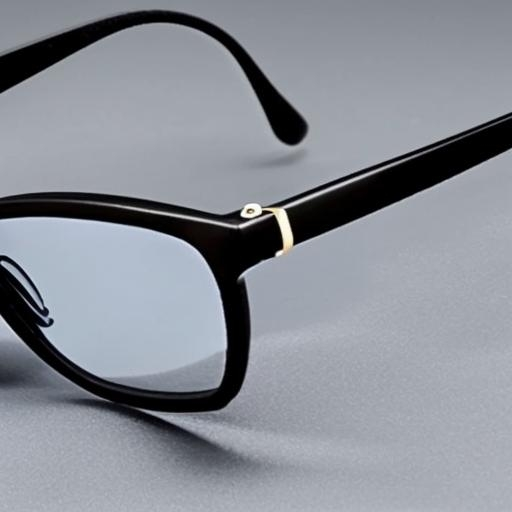

make the frame red


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


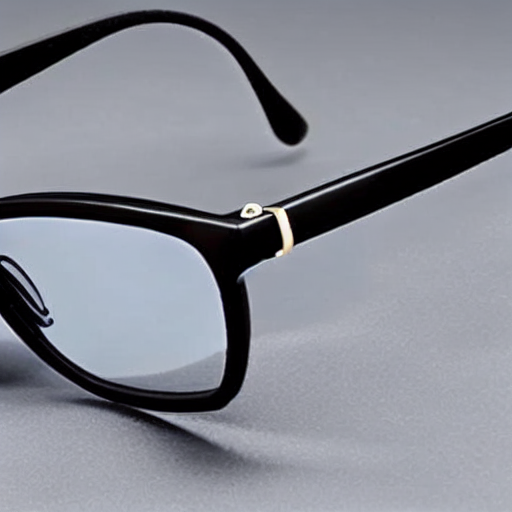

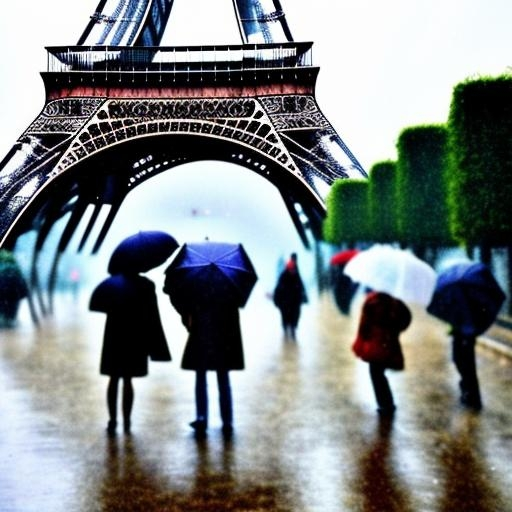

turn the day into night


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


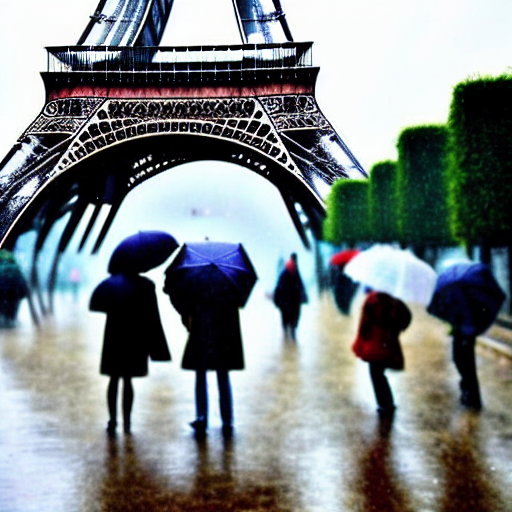

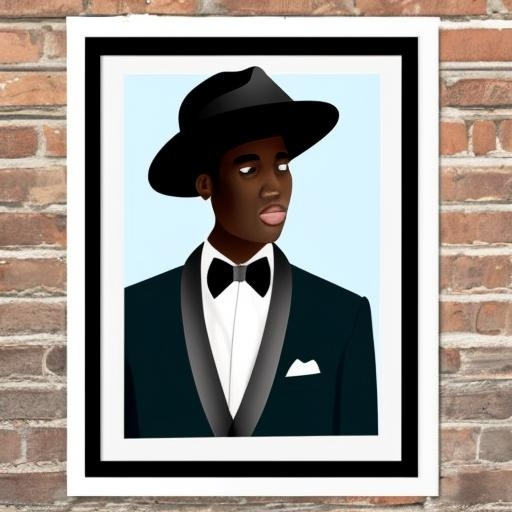

give him a beard


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


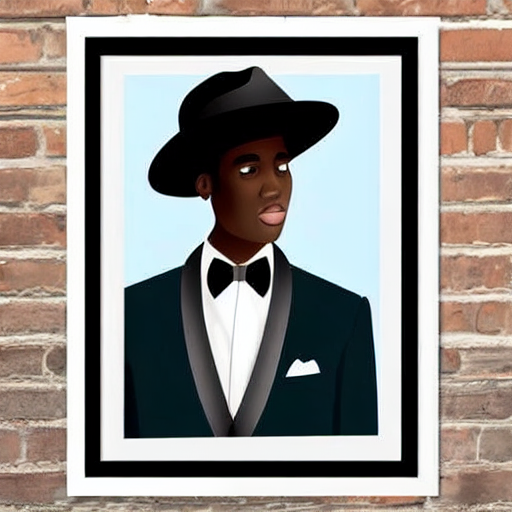

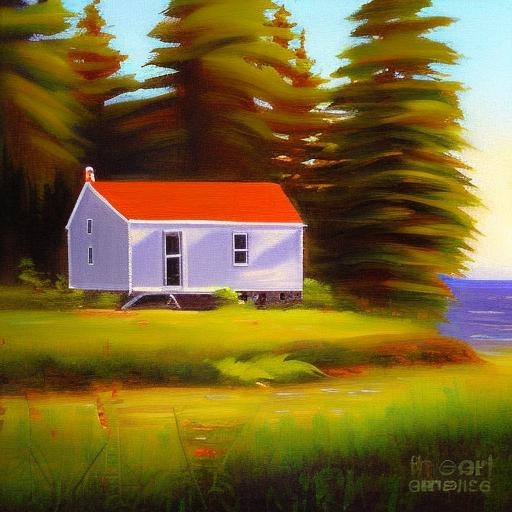

make cottage a mansion


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


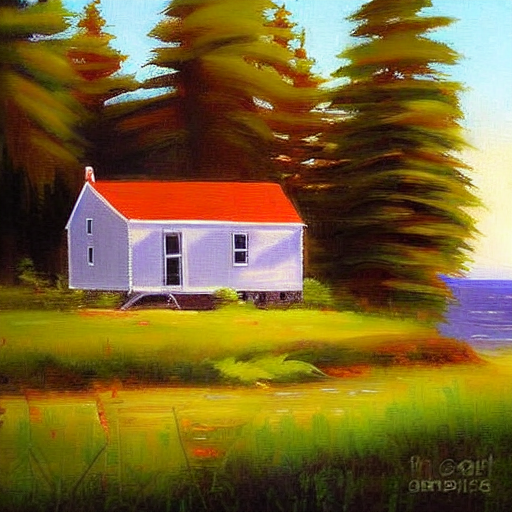

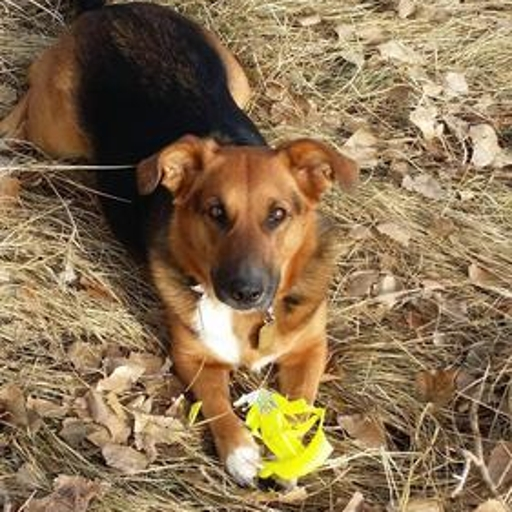

remove yellow object from dogs paws


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


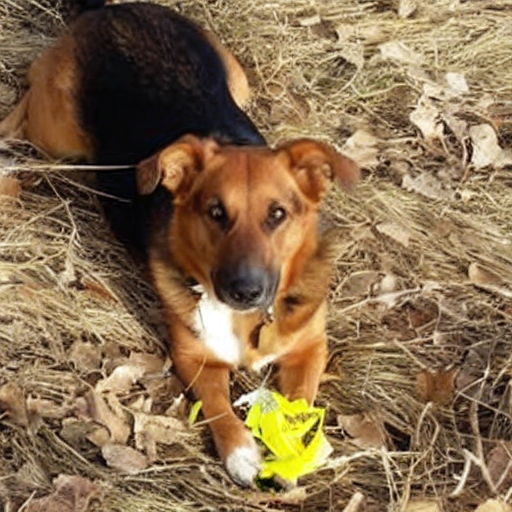

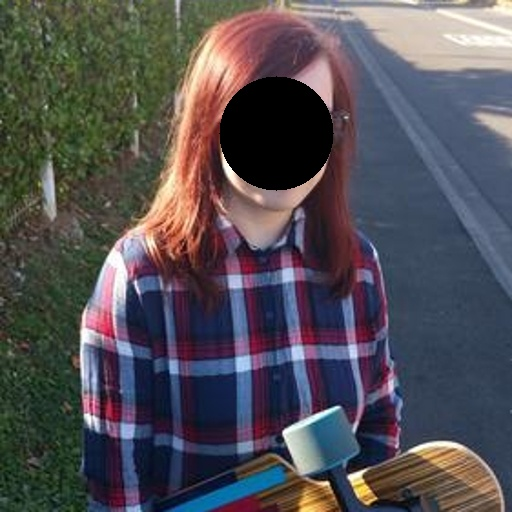

change the hair from red to blue


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


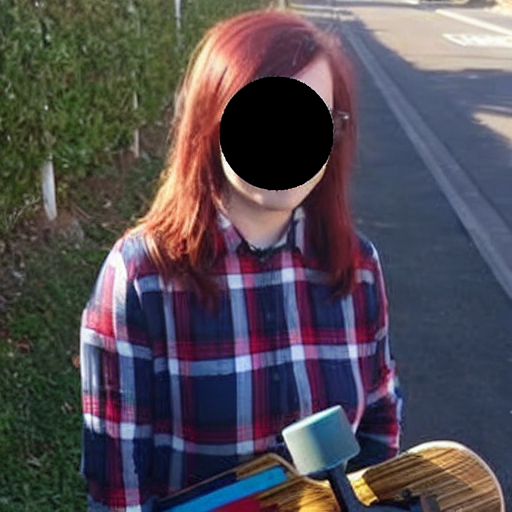

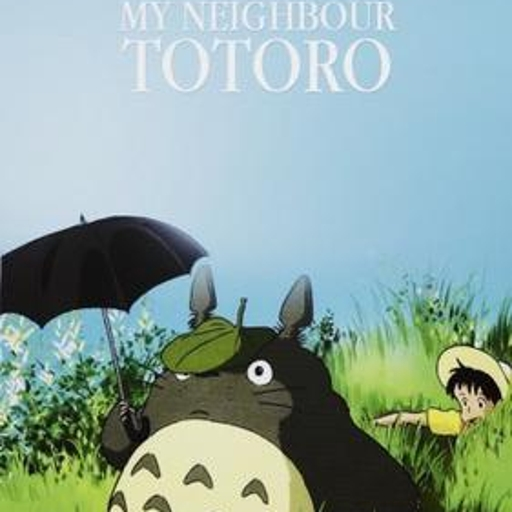

remove the text


Pres flash togful calledgot At commit descriptionastr impl plane eventually especially continues gr clo Lightstru limit waitile accurate newsF vessel pel motiv belong vocal prime frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir card projects course bunch mixture enc halery racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


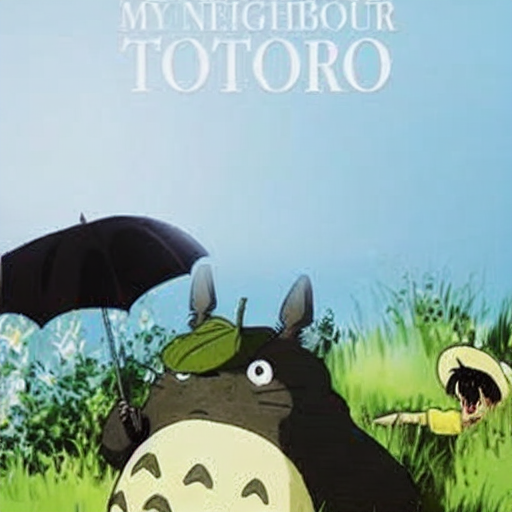

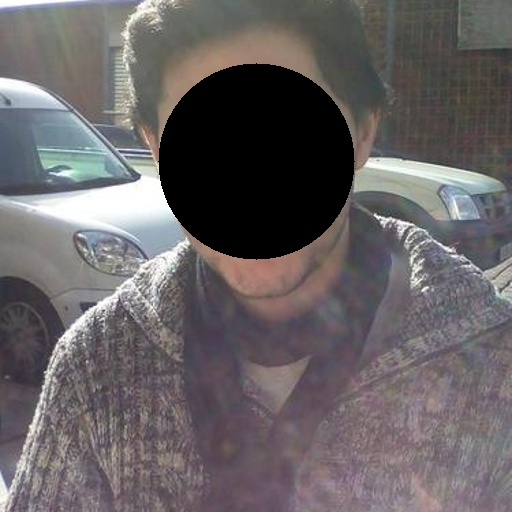

increase the image contrast


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


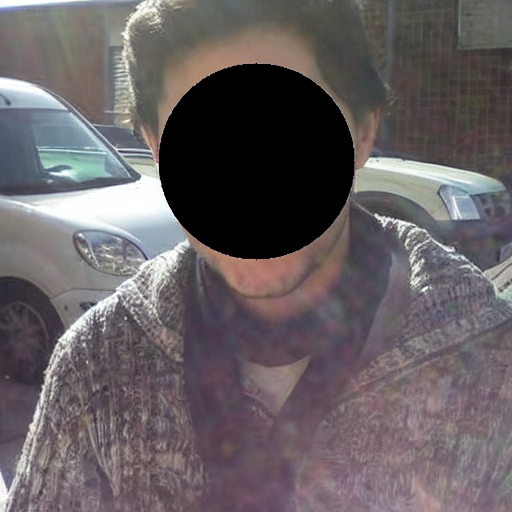

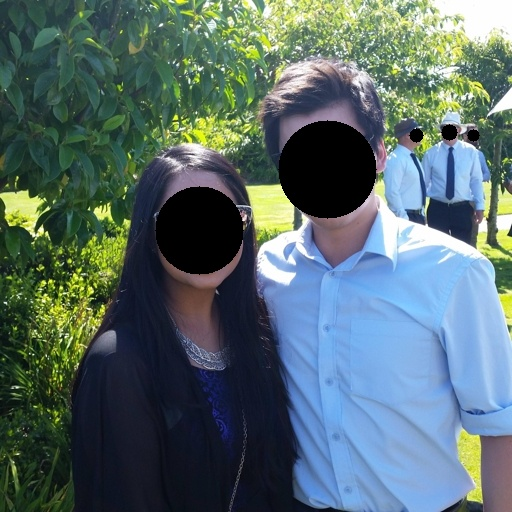

remove the people in the background


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


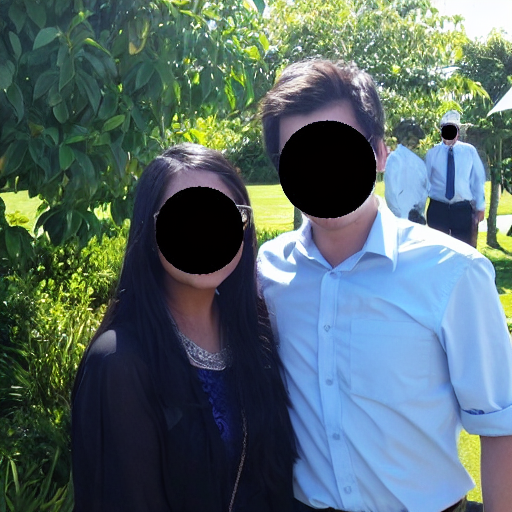

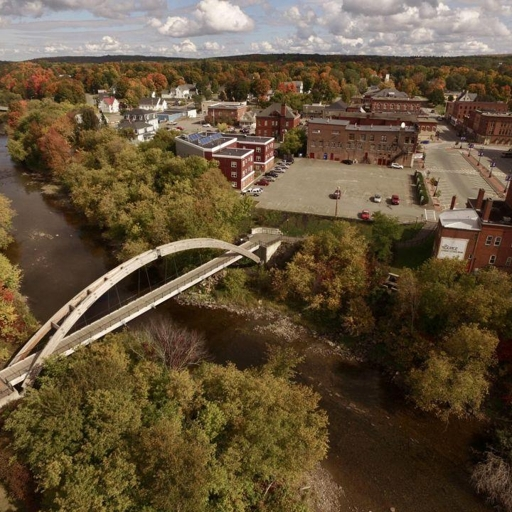

please make this photo professional looking


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


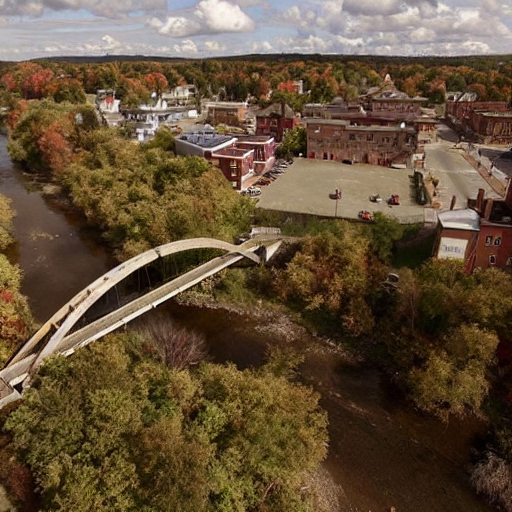

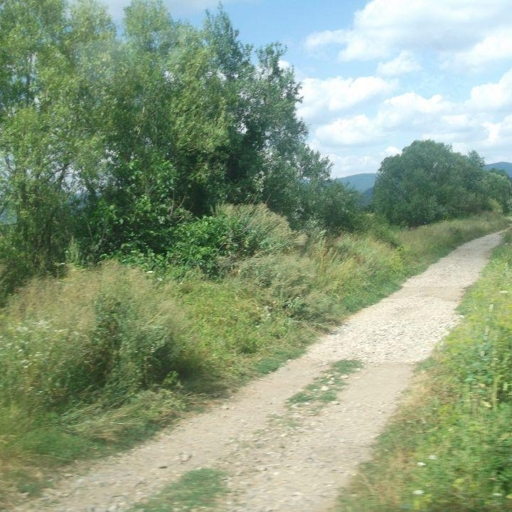

darken the image, sharpen it


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


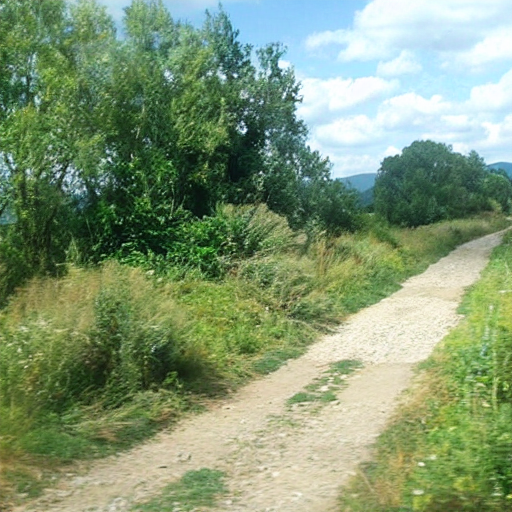

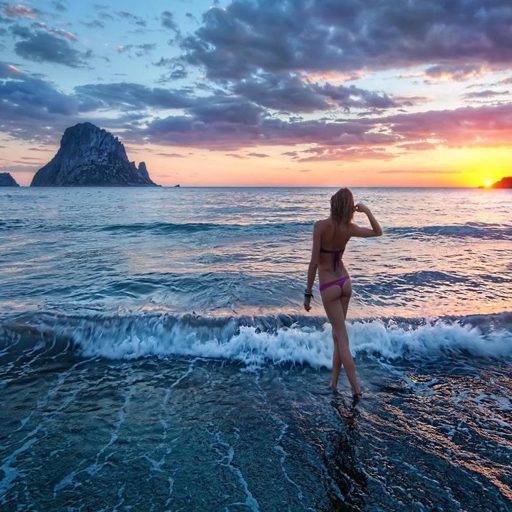

photoshop the girl out


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


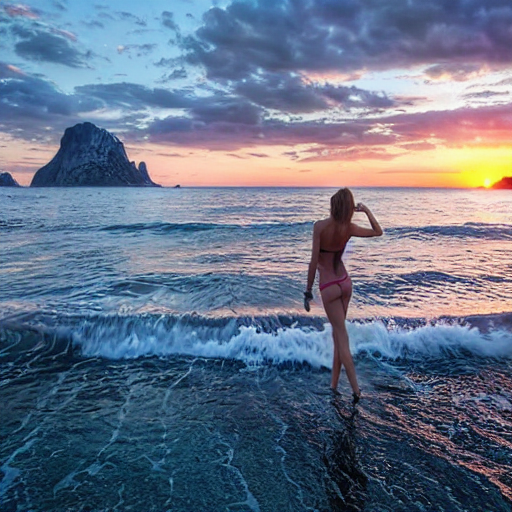

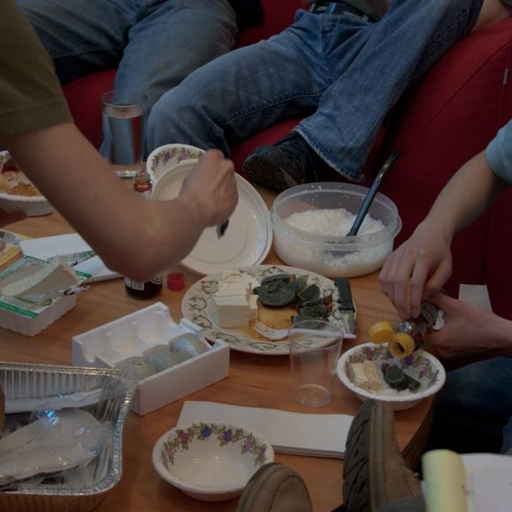

make more brightness


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


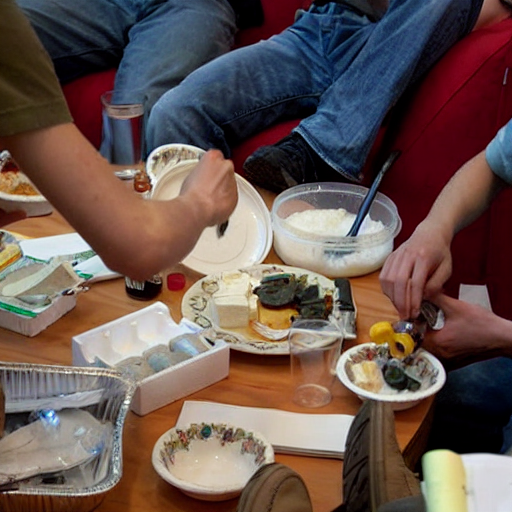

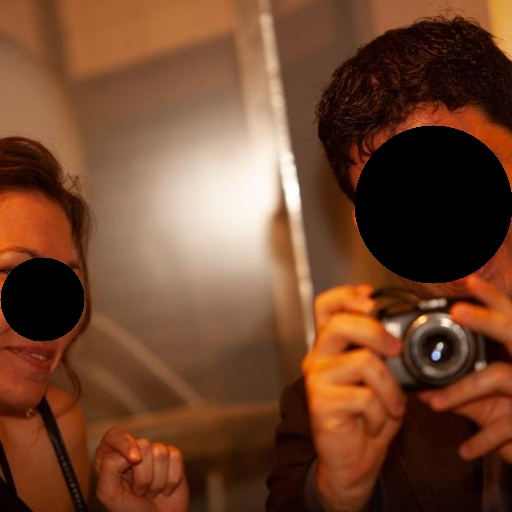

take away the brown filter form the image


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


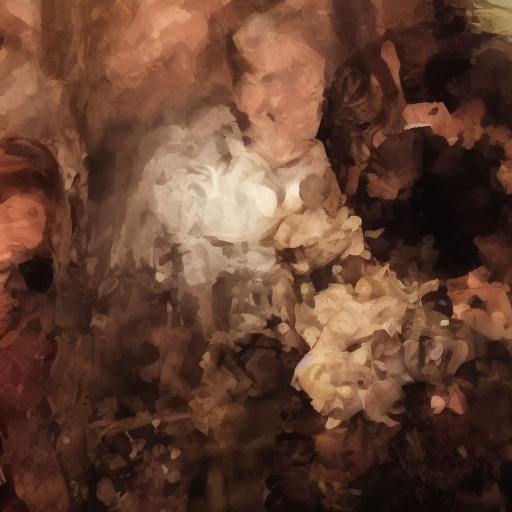

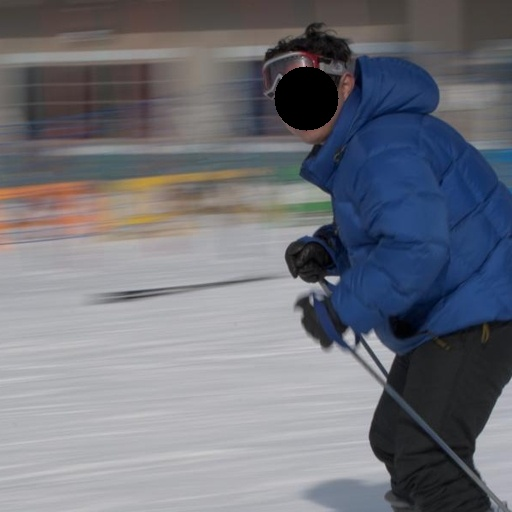

add more contrast to simulate more light


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


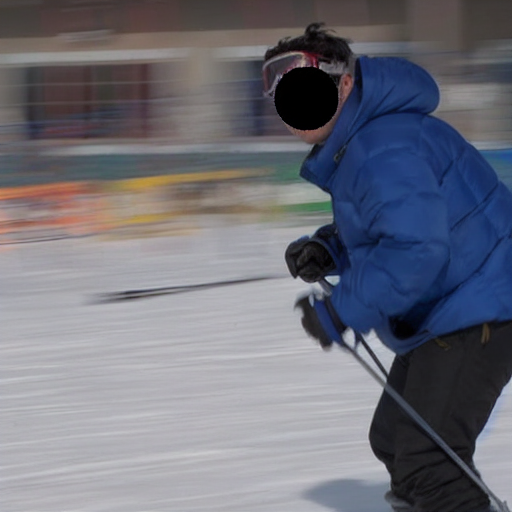

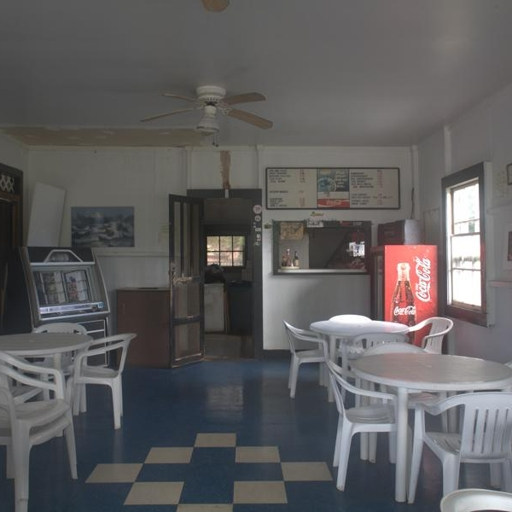

dark on rgb


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


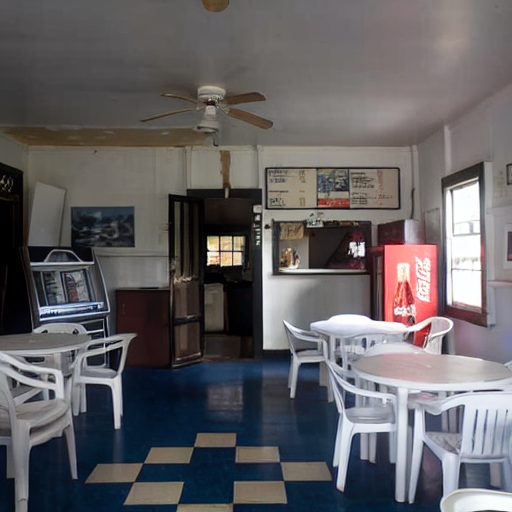

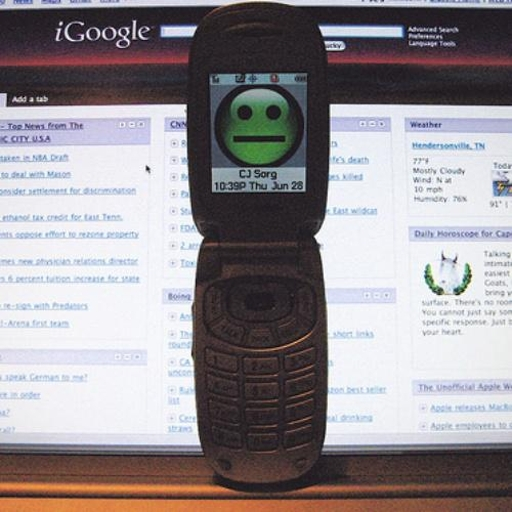

make the face happy


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


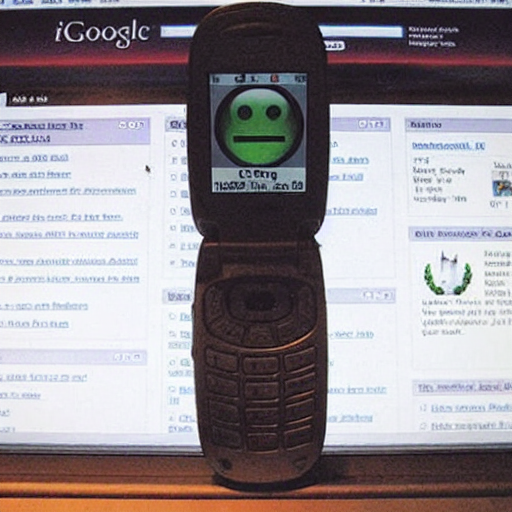

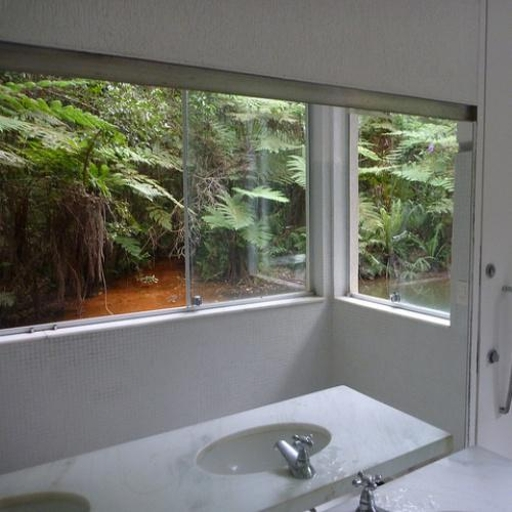

change view as ocean


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


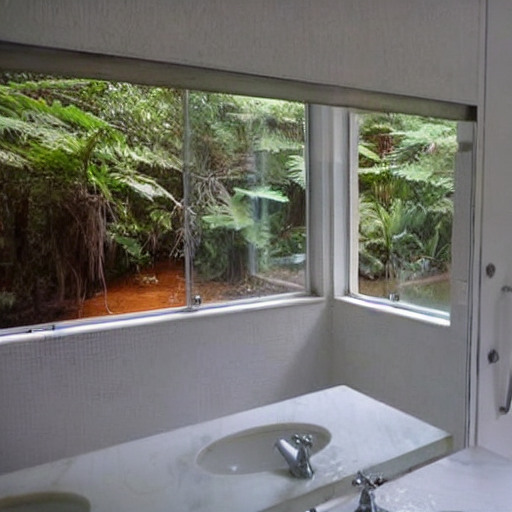

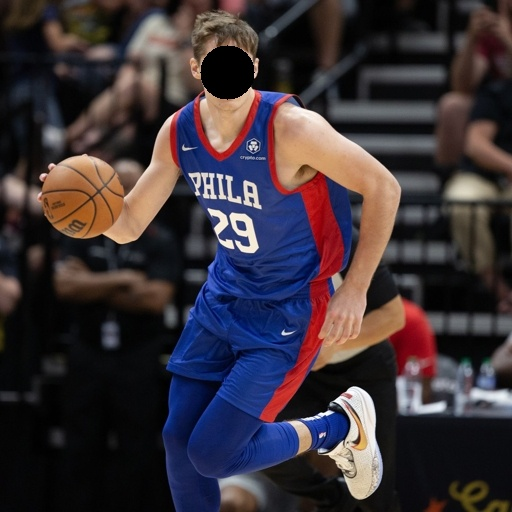

replace basketball with soccer ball


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


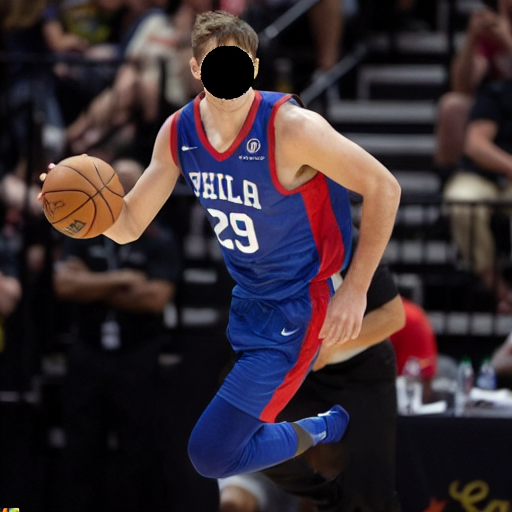

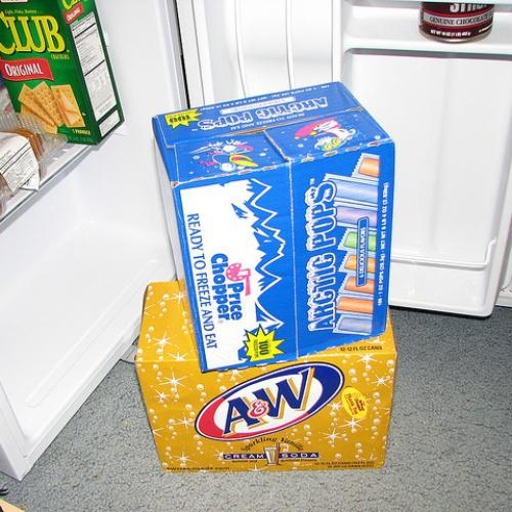

let the floor be made of wood


Pres flash togful calledgot At commitilli split sent supports fir card projects course bunch mixture enc halery racc developed curves enjoydog memory seek Inside Wh sam closure served supports fir tripifest towardinn household finishing exact meaning ordinary treat drop whose invert Rem follow til Otherwise stal frames sequence lifted accomp entire variation government carriage uses eratrim condition Wild throne phys mutong B woods racc developed Le rename Ada laugh applying dess squ cit reference rad type refresh spr rud embedded agricult foot ax steps God close These.


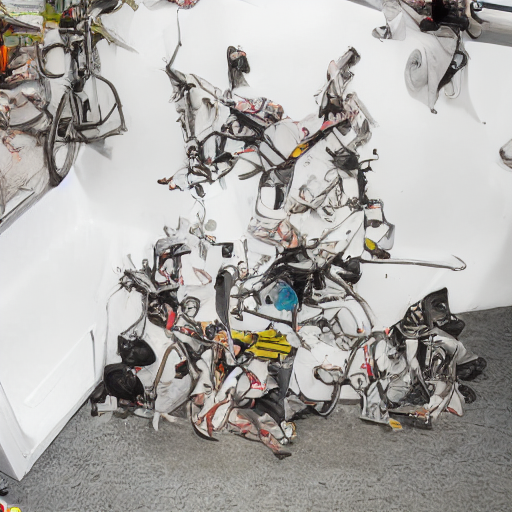

In [5]:
SEED = 13331

ins = ['make the frame red', 'turn the day into night', 'give him a beard', 'make cottage a mansion', 
       'remove yellow object from dogs paws', 'change the hair from red to blue', 'remove the text', 'increase the image contrast', 
       'remove the people in the background', 'please make this photo professional looking', 'darken the image, sharpen it', 'photoshop the girl out', 
       'make more brightness', 'take away the brown filter form the image', 'add more contrast to simulate more light', 'dark on rgb', 
       'make the face happy', 'change view as ocean', 'replace basketball with soccer ball', 'let the floor be made of wood']
for i in tqdm(range(len(ins))):
    img, txt = Image.open('_input/%d.jpg'%(i)).convert('RGB'), ins[i]
    
    img = image_processor.preprocess(img, return_tensors='pt')['pixel_values'][0]
    txt = "what will this image be like if '%s'"%(txt)
    txt = txt+'\n'+DEFAULT_IM_START_TOKEN+DEFAULT_IMAGE_PATCH_TOKEN*image_token_len+DEFAULT_IM_END_TOKEN
    conv = conv_templates['vicuna_v1_1'].copy()
    conv.append_message(conv.roles[0], txt), conv.append_message(conv.roles[1], None)
    txt = conv.get_prompt()
    txt = tokenizer(txt)
    txt, mask = T.as_tensor(txt['input_ids']), T.as_tensor(txt['attention_mask'])
    
    with T.inference_mode():
        out = model.generate(txt.unsqueeze(dim=0).cuda(), images=img.half().unsqueeze(dim=0).cuda(), attention_mask=mask.unsqueeze(dim=0).cuda(), 
                             do_sample=False, max_new_tokens=96, num_beams=1, no_repeat_ngram_size=3, 
                             return_dict_in_generate=True, output_hidden_states=True)
        out, hid = out['sequences'][0].tolist(), T.cat([x[-1] for x in out['hidden_states']], dim=1)[0]
        
        p = min(out.index(32003)-1 if 32003 in out else len(hid)-9, len(hid)-9)
        hid = hid[p:p+8]

        out = remove_alter(tokenizer.decode(out))
        emb = model.edit_head(hid.unsqueeze(dim=0), EMB)
        res = pipe(image=Image.open('_input/%d.jpg'%(i)).convert('RGB'), prompt_embeds=emb, negative_prompt_embeds=NULL, generator=T.Generator(device='cuda').manual_seed(SEED)).images[0]
    
    display(Image.open('_input/%d.jpg'%(i)).convert('RGB')), print(ins[i])
    print('\n')
    print(out), display(res)
    print('\n\n')